In [1]:
import os
from IPython.display import display, Image
import random
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras import layers, models
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array

LOAD DATA


In [2]:
data=tf.keras.utils.image_dataset_from_directory('./categories')

Found 575 files belonging to 4 classes.


In [3]:
data

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [4]:
train_data_dir = './categories'

# Set the desired image size (e.g., 128x128)
desired_image_size = (256, 256)

# Use image_dataset_from_directory to create a labeled dataset
data = tf.keras.utils.image_dataset_from_directory(
    train_data_dir,
    batch_size=32,               # Adjust batch size as needed
    image_size=desired_image_size,  # Specify the desired image size
    shuffle=True,                # Shuffle the dataset
    seed=123                     # Set seed for reproducibility
)

Found 575 files belonging to 4 classes.


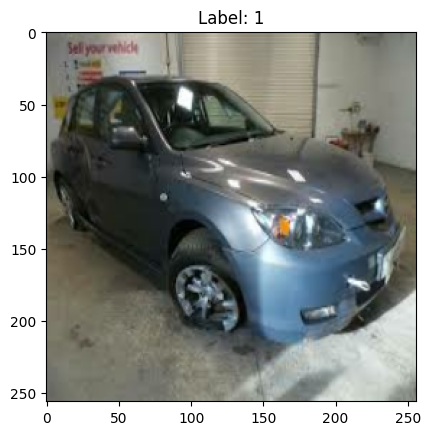

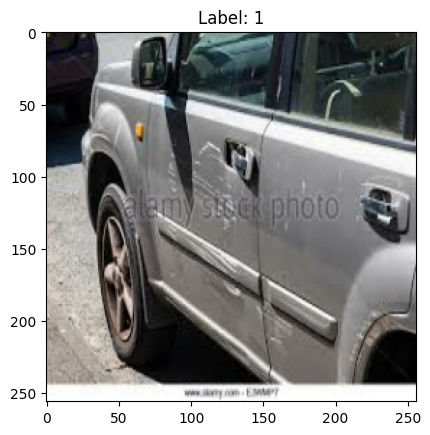

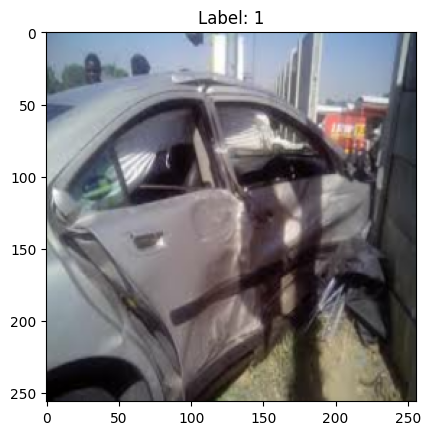

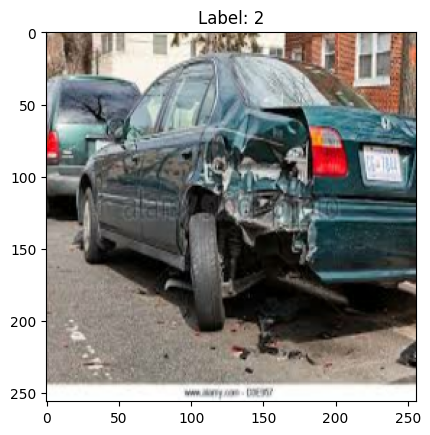

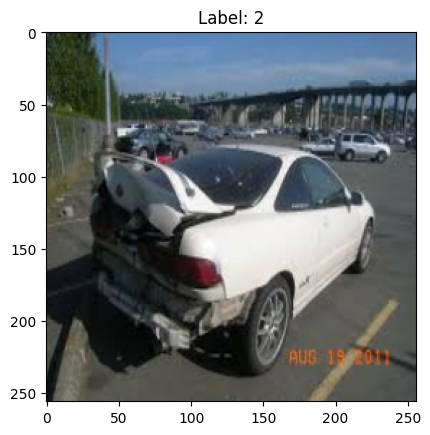

...

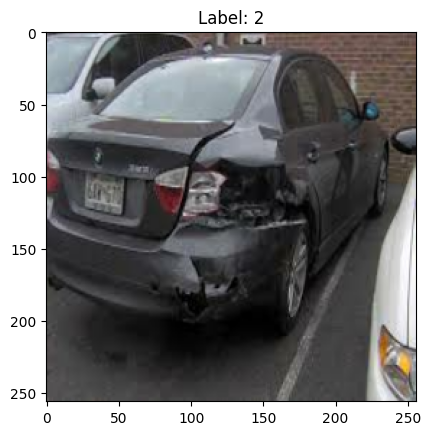

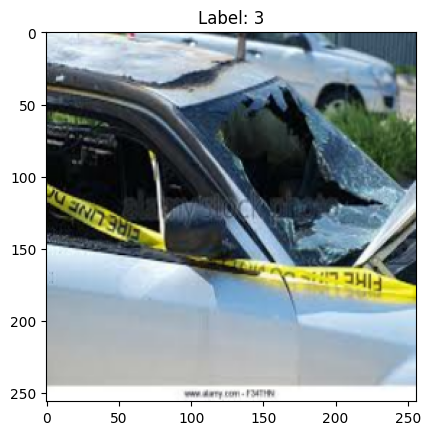

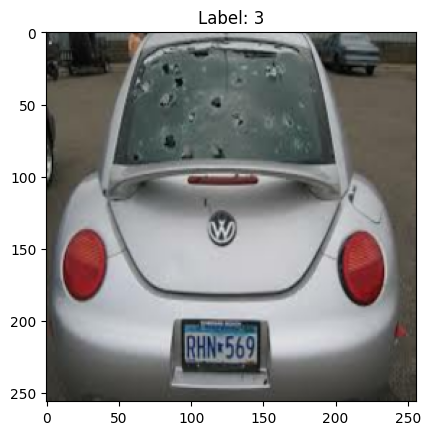

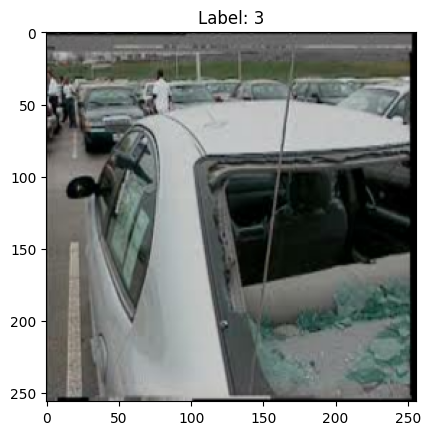

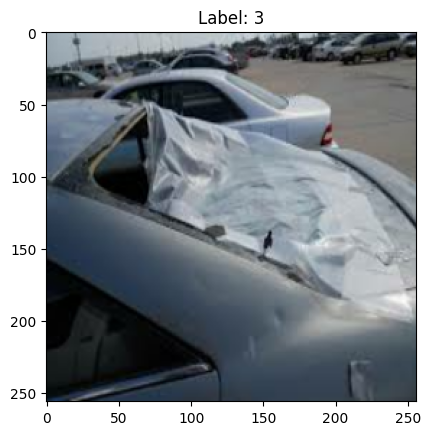

In [5]:
# for element in data:
#     images, labels = element
#     for i in range(len(images)):
#         # Assuming you are using matplotlib to display images
#         plt.imshow(images[i].numpy().astype("uint8"))
#         plt.title(f"Label: {labels[i].numpy()}")
#         plt.show()

# Counter to keep track of the number of images printed
# Define a dictionary to keep track of the number of images shown for each class
num_images_shown_per_class = {}

# Iterate through the dataset and print only the first 10 images from each class
for images, labels in data:
    for i in range(len(images)):
        label = labels[i].numpy()
        
        # Check if the current label exists in the dictionary
        if label not in num_images_shown_per_class:
            num_images_shown_per_class[label] = 0
        
        # Display the image using matplotlib if fewer than 10 images have been shown for this class
        if num_images_shown_per_class[label] < 5:
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(f"Label: {label}")
            plt.show()
            
            # Increment the counter for the current class
            num_images_shown_per_class[label] += 1
            
        # Check if 10 images have been shown for each class
        if all(count >= 10 for count in num_images_shown_per_class.values()):
            break
            
    # Check if 10 images have been shown for each class
    if all(count >= 10 for count in num_images_shown_per_class.values()):
        break



In [6]:
   #  print(f"Type of element: {type(element)}")
print(f"Type of images: {type(images)}")
print(f"Type of labels: {type(labels)}")


Type of images: <class 'tensorflow.python.framework.ops.EagerTensor'>
Type of labels: <class 'tensorflow.python.framework.ops.EagerTensor'>


In [7]:
# Check the size of the images
image_size = data.element_spec[0].shape[1:3]
print("Image size:", image_size)

Image size: (256, 256)


In [8]:
data_iterator=data.as_numpy_iterator()
batch=data_iterator.next()
#image representative as numpy array
print(len(batch))
batch[0].shape
batch[1]

2


array([3, 0, 0, 0, 2, 1, 1, 2, 0, 2, 2, 3, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0,
       0, 0, 3, 2, 1, 1, 1, 1, 0, 0])

In [9]:
batch_size = batch[0].shape[0]
print("Batch size:", batch_size)

Batch size: 32


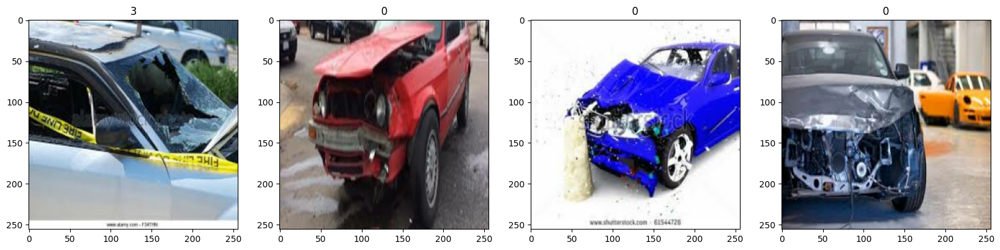

In [10]:
fig,ax=plt.subplots(ncols=4,figsize=(20,20))
for idx,img in enumerate(batch[0][:4]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(batch[1][idx])

Pre_Process Data

In [11]:
data=data.map(lambda x,y: (x/255 ,y))

In [12]:
data.as_numpy_iterator().next()

(array([[[[0.27062654, 0.23533241, 0.17630975],
          [0.12216605, 0.08687194, 0.02020527],
          [0.14584099, 0.11104473, 0.04238664],
          ...,
          [0.42259496, 0.4814185 , 0.07849265],
          [0.24208793, 0.30815718, 0.00567555],
          [0.30771294, 0.3782016 , 0.        ]],
 
         [[0.18565123, 0.15035711, 0.08678089],
          [0.17970142, 0.14458524, 0.07756268],
          [0.14495583, 0.11219909, 0.04569002],
          ...,
          [0.3307848 , 0.38404644, 0.03173433],
          [0.32632408, 0.385563  , 0.05840641],
          [0.3056506 , 0.3668542 , 0.00837251]],
 
         [[0.161541  , 0.12752599, 0.0557429 ],
          [0.21481526, 0.18100151, 0.10881587],
          [0.14589651, 0.11452396, 0.04350508],
          ...,
          [0.30034697, 0.34120482, 0.0446038 ],
          [0.3694965 , 0.4139643 , 0.10036992],
          [0.34995395, 0.3958697 , 0.07648367]],
 
         ...,
 
         [[1.        , 1.        , 1.        ],
          [1.     

In [13]:
len(data) #represent batch size

18

In [14]:
train_size=int(len(data)*.7)-1
val_size=int(len(data)*.2)+1
test_size=int(len(data)*.1)+1

In [15]:
print(train_size,val_size,test_size)

11 4 2


In [16]:
train=data.take(train_size)
val=data.skip(train_size).take(val_size)
test=data.skip(train_size+val_size).take(test_size)

In [17]:
#Assuming 4 classes (adjust as needed)
num_classes = 4

# Image size
img_height, img_width = 256, 256

model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(256, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(256, activation='relu'),
    layers.Dense(num_classes, activation='softmax')  # Multi-class classification, so using softmax activation
])

c:\Users\PC\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


In [18]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 254, 254, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 127, 127, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 125, 125, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 62, 62, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 60, 60, 256)    │       147,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 30, 30, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 230400)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │    58,982,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 4)              │         1,028 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 59,150,788 (225.64 MB)

 Trainable params: 59,150,788 (225.64 MB)

 Non-trainable params: 0 (0.00 B)

In [19]:
# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

TRAin model


In [20]:
logsdir='.\logs'

<>:1: SyntaxWarning: invalid escape sequence '\l'
<>:1: SyntaxWarning: invalid escape sequence '\l'
C:\Users\PC\AppData\Local\Temp\ipykernel_15904\2887880687.py:1: SyntaxWarning: invalid escape sequence '\l'
  logsdir='.\logs'


In [21]:
tensorboard_callback=tf.keras.callbacks.TensorBoard(log_dir=logsdir)

In [22]:
hist=model.fit(train,epochs=9,validation_data=val,callbacks=[tensorboard_callback])

Epoch 1/9
11/11 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.3417 - loss: 3.9368 - val_accuracy: 0.3125 - val_loss: 1.2939
Epoch 2/9
11/11 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.3795 - loss: 1.2216 - val_accuracy: 0.4688 - val_loss: 1.1665
Epoch 3/9
11/11 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.4324 - loss: 1.1895 - val_accuracy: 0.4297 - val_loss: 1.1889
Epoch 4/9
11/11 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.5032 - loss: 1.0839 - val_accuracy: 0.5625 - val_loss: 1.0232
Epoch 5/9
11/11 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.5333 - loss: 1.0183 - val_accuracy: 0.5781 - val_loss: 0.9305
Epoch 6/9
11/11 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.6000 - loss: 0.9633 - val_accuracy: 0.6875 - val_loss: 0.8728
Epoch 7/9
11/11 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.6846 - loss: 0.8097 - val_accuracy: 0.7500 - val_loss: 0.7197
Epoch 8/9
11/11 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.7723 - loss: 0.6365 - val_accuracy: 0.7812 - val_loss: 0.5780


In [23]:
hist.history

{'accuracy': [0.37784090638160706,
  0.44034090638160706,
  0.4545454680919647,
  0.5056818127632141,
  0.5482954382896423,
  0.5965909361839294,
  0.6960227489471436,
  0.7528409361839294,
  0.8664772510528564],
 'loss': [3.065329074859619,
  1.19795560836792,
  1.1865397691726685,
  1.1027073860168457,
  1.0112727880477905,
  0.9571000933647156,
  0.7573917508125305,
  0.6722198724746704,
  0.4417789578437805],
 'val_accuracy': [0.3125,
  0.46875,
  0.4296875,
  0.5625,
  0.578125,
  0.6875,
  0.75,
  0.78125,
  0.90625],
 'val_loss': [1.2938792705535889,
  1.1664550304412842,
  1.1888890266418457,
  1.0232281684875488,
  0.9305309653282166,
  0.8728371858596802,
  0.7197290658950806,
  0.5780395269393921,
  0.30879902839660645]}

PLOT Performance

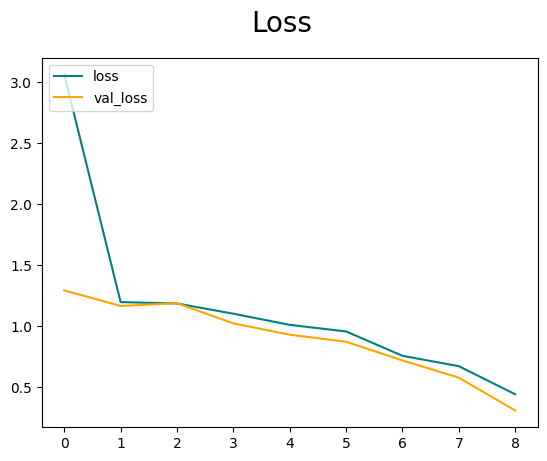

In [24]:
fig=plt.figure()
plt.plot(hist.history['loss'],color='teal',label='loss')
plt.plot(hist.history['val_loss'],color='orange',label='val_loss')
fig.suptitle('Loss',fontsize=20)
plt.legend(loc="upper left")
plt.show()

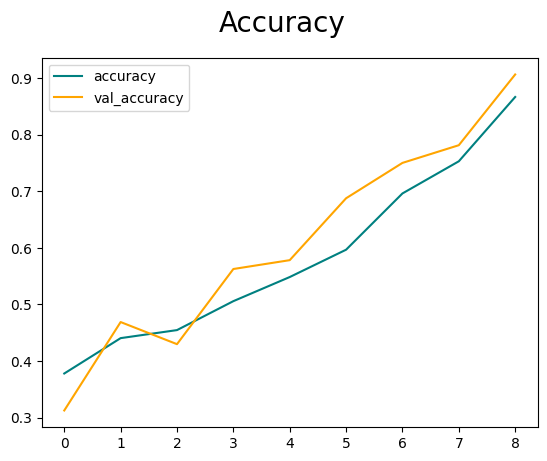

In [25]:
fig=plt.figure()
plt.plot(hist.history['accuracy'],color='teal',label='accuracy')
plt.plot(hist.history['val_accuracy'],color='orange',label='val_accuracy')
fig.suptitle('Accuracy',fontsize=20)
plt.legend(loc="upper left")
plt.show()

Evaluate Performance


In [26]:
#For confusion matrix
import numpy as np
from sklearn.metrics import confusion_matrix
import seaborn as sns

true_labels = []
predicted_labels = []

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    yhat_classes = np.argmax(yhat, axis=1)
    true_labels.extend(y)
    predicted_labels.extend(yhat_classes)

true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Confusion Matrix:
[[23  1  2  0]
 [ 2 23  2  0]
 [ 1  1  7  0]
 [ 0  0  0  2]]


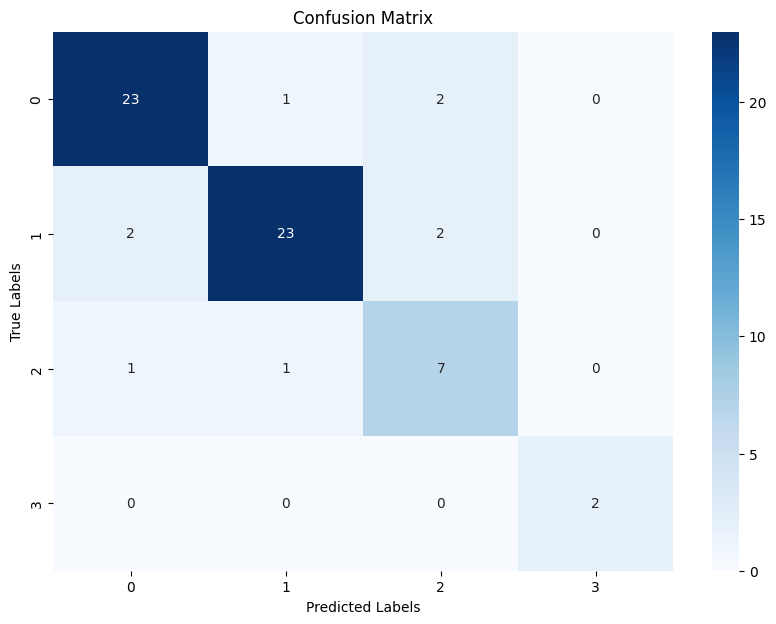

In [27]:
# Compute the confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Print the confusion matrix
print("Confusion Matrix:")
print(cm)

# Plot the confusion matrix using Seaborn for better visualization
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=True, yticklabels=True)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

In [28]:
from tensorflow.keras.metrics import Precision,Recall,SparseCategoricalAccuracy,CategoricalAccuracy

In [29]:
pre=Precision()
re=Recall()
acc=CategoricalAccuracy()

In [31]:
pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    print(y.shape)
    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    for actual, predicted in zip(y, yhat_classes):
        print(f"Actual: {actual}, Predicted: {predicted}")
    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y, yhat_classes)
    re.update_state(y, yhat_classes)
    acc.update_state(y, yhat_classes)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
(32,)
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 2, Predicted: 2
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 2, Predicted: 2
Actual: 2, Predicted: 0
Actual: 2, Predicted: 2
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 2, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 2, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 0
Actual: 1, Predicted: 2
Actual: 0, Predicted: 1
Actual: 0, Predicted: 2
Actual: 0, Predicted: 0
Actual: 2, Predicted: 2
Actual: 1, Predicted: 1
Actual: 2, Predicted: 2
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
(32,)
Actual: 1, Predicted: 0
Actual: 0, Predicted: 0
Actual: 2, Predicted: 2
Actual: 3, Predicted: 3
Actual: 2, Predicted: 2
Actual: 0, Predicted: 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
Actual: 0, Predicted: 0


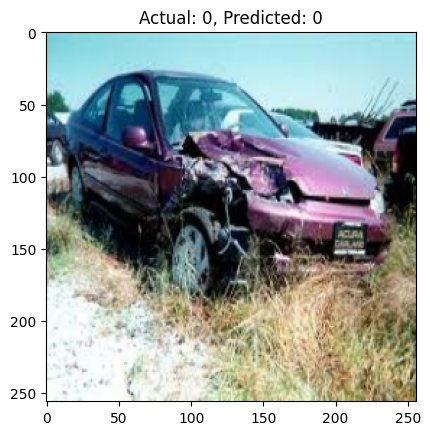

Actual: 2, Predicted: 1


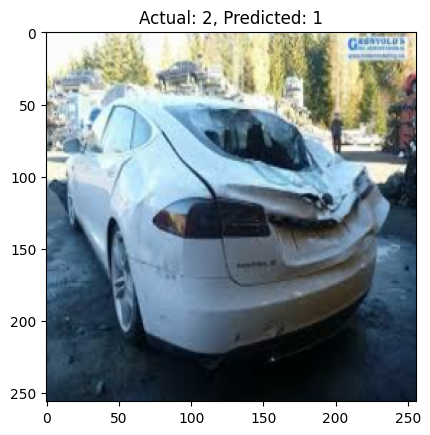

Actual: 2, Predicted: 2


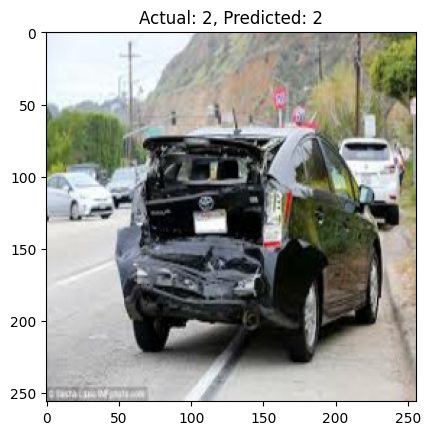

Actual: 0, Predicted: 0


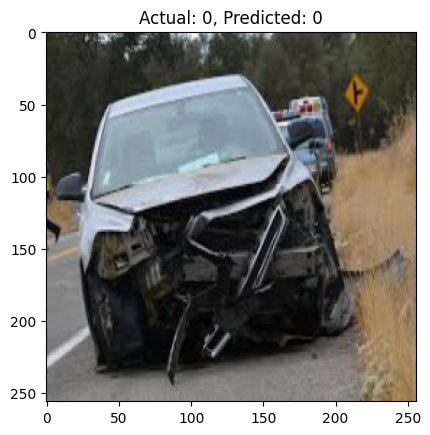

Actual: 2, Predicted: 2


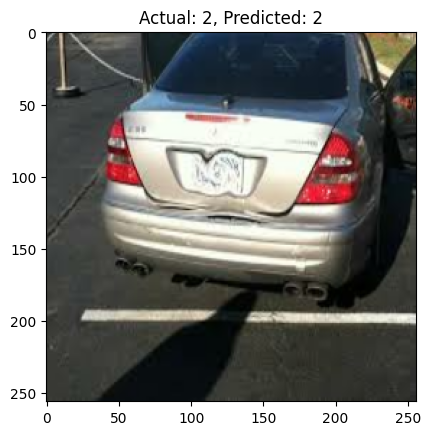

Actual: 2, Predicted: 2


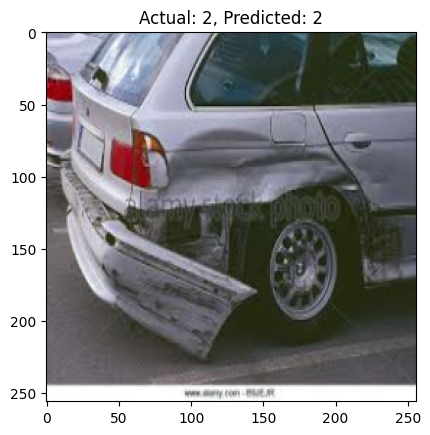

Actual: 0, Predicted: 0


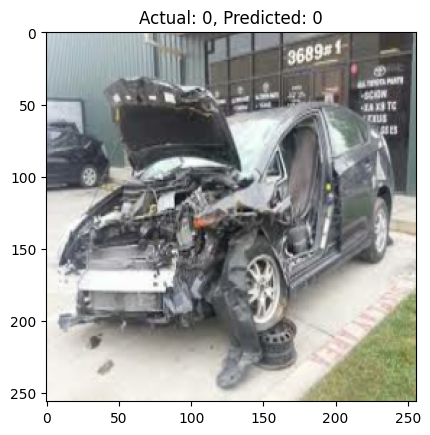

Actual: 0, Predicted: 0


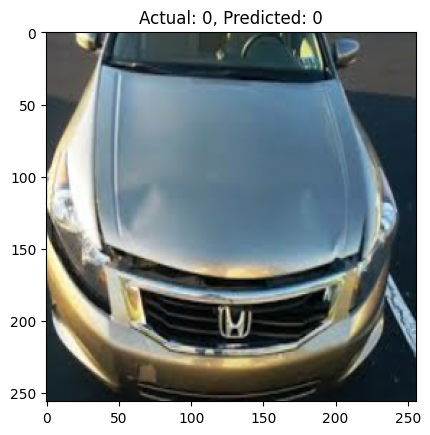

Actual: 0, Predicted: 0


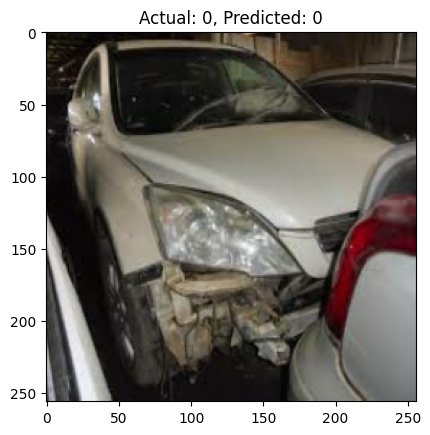

Actual: 1, Predicted: 1


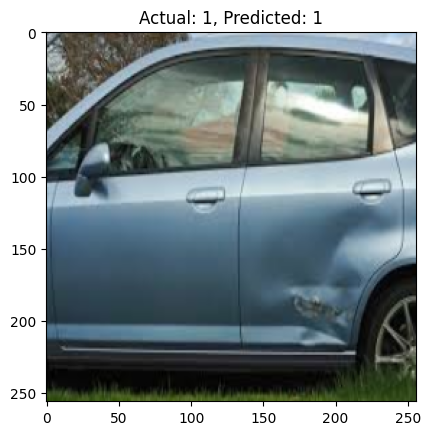

Actual: 1, Predicted: 1


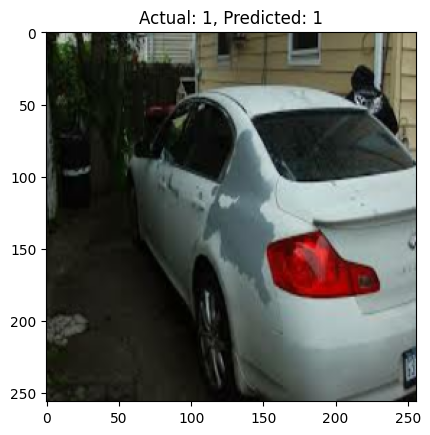

Actual: 0, Predicted: 0


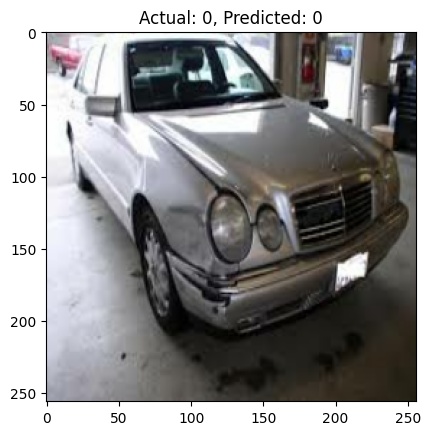

Actual: 0, Predicted: 0


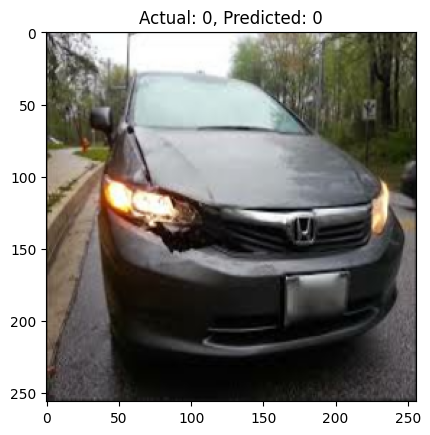

Actual: 0, Predicted: 0


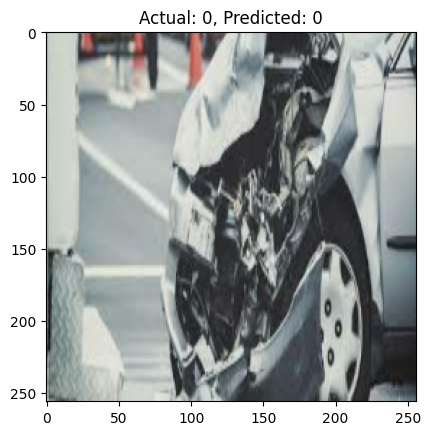

Actual: 3, Predicted: 0


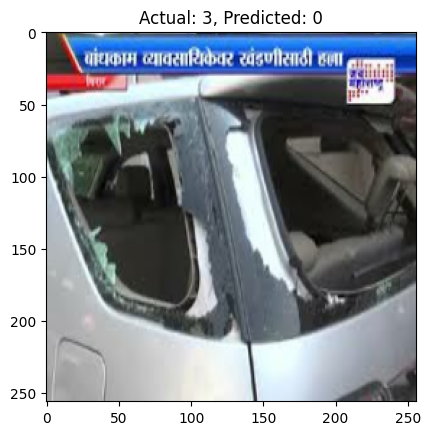

Actual: 1, Predicted: 1


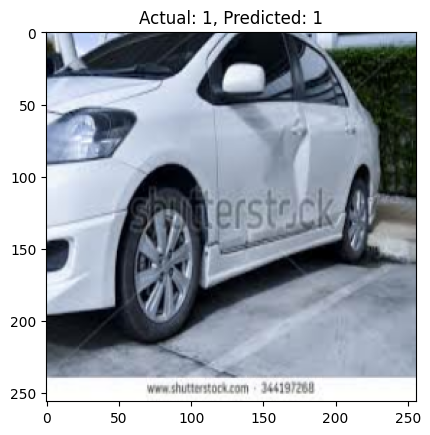

Actual: 1, Predicted: 1


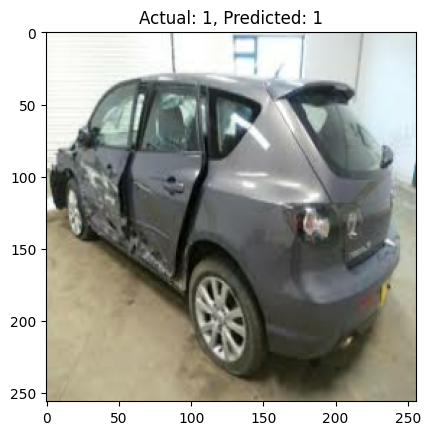

Actual: 0, Predicted: 0


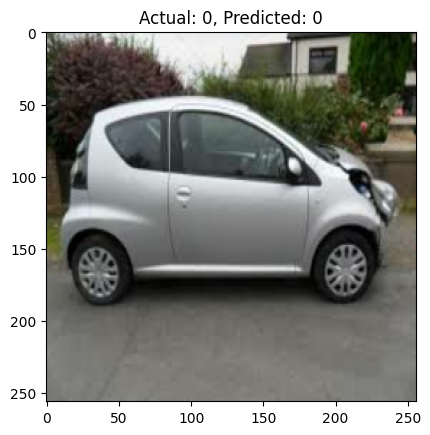

Actual: 0, Predicted: 0


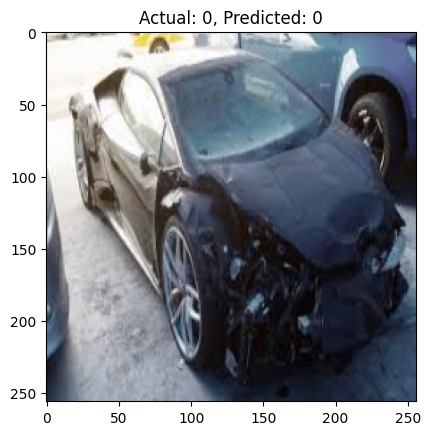

Actual: 0, Predicted: 0


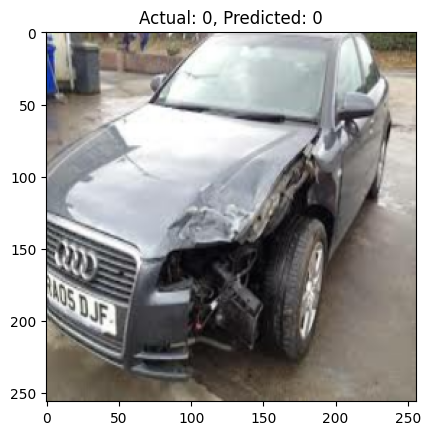

Actual: 0, Predicted: 0


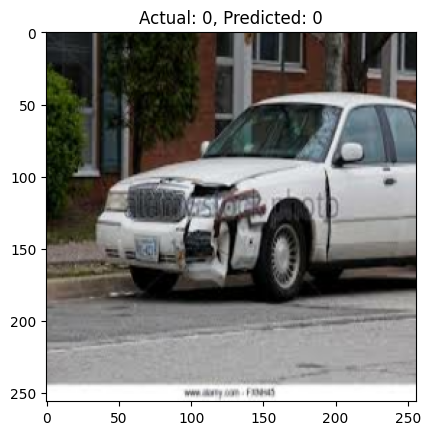

Actual: 1, Predicted: 1


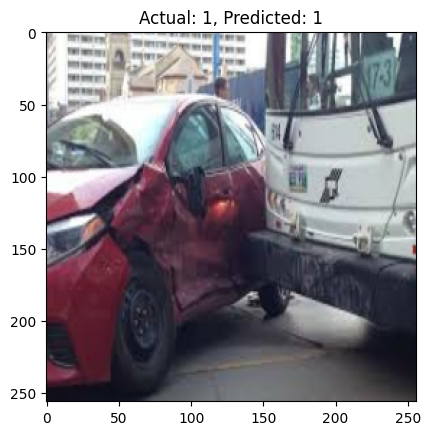

Actual: 0, Predicted: 0


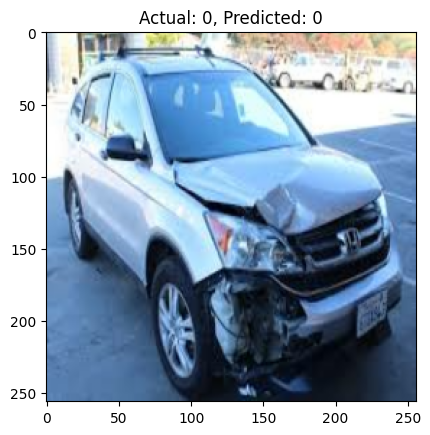

Actual: 0, Predicted: 0


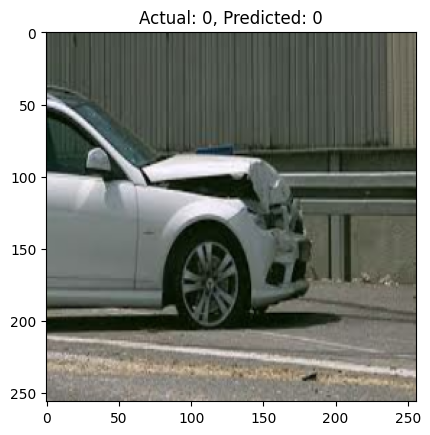

Actual: 0, Predicted: 0


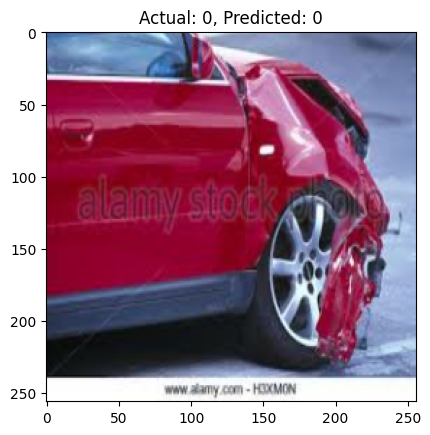

Actual: 2, Predicted: 0


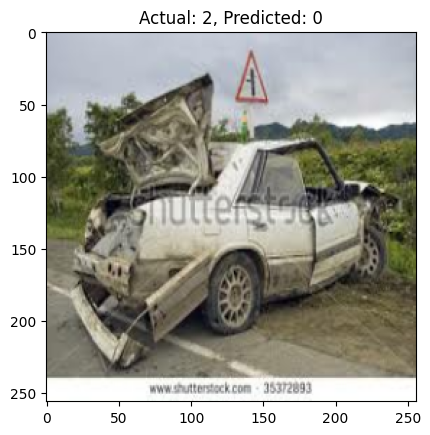

Actual: 1, Predicted: 1


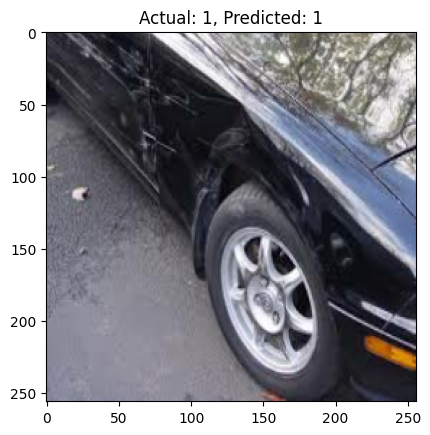

Actual: 0, Predicted: 0


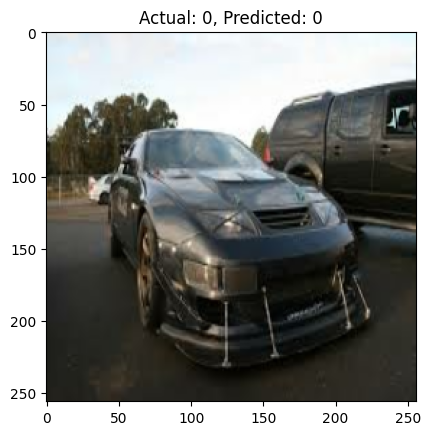

Actual: 0, Predicted: 0


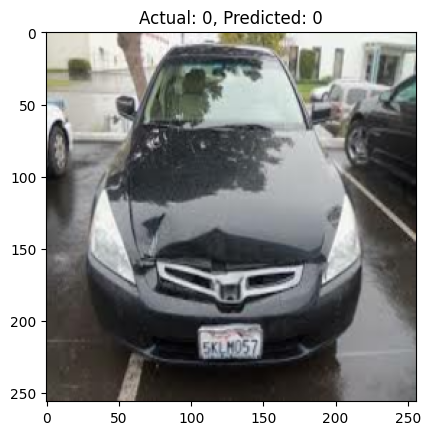

Actual: 1, Predicted: 1


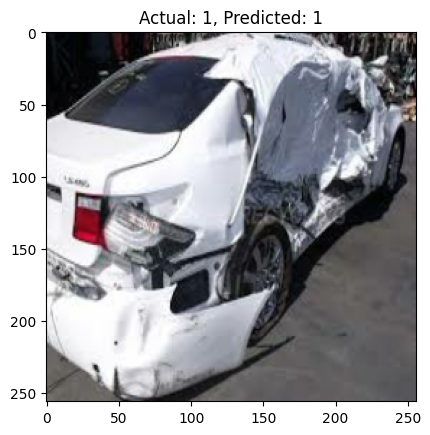

Actual: 1, Predicted: 1


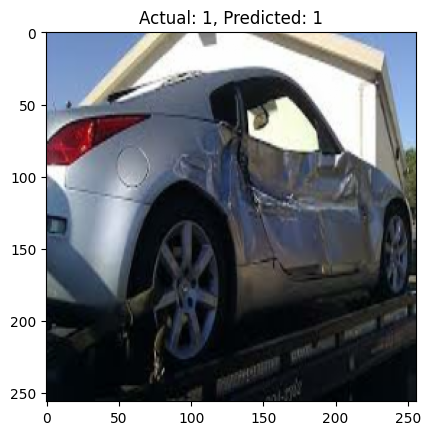

Actual: 0, Predicted: 1


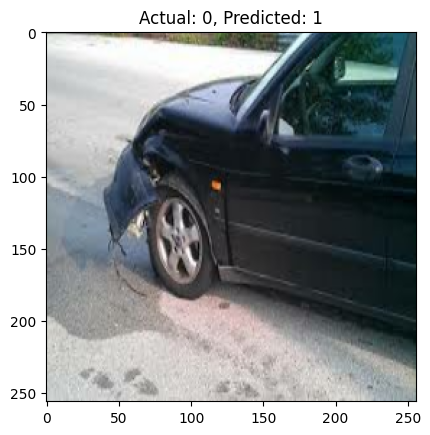

(32,) (32,)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
Actual: 0, Predicted: 0


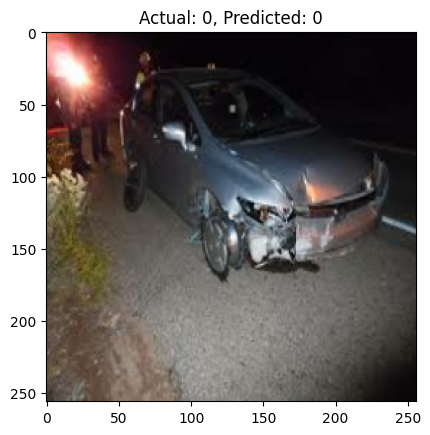

Actual: 1, Predicted: 1


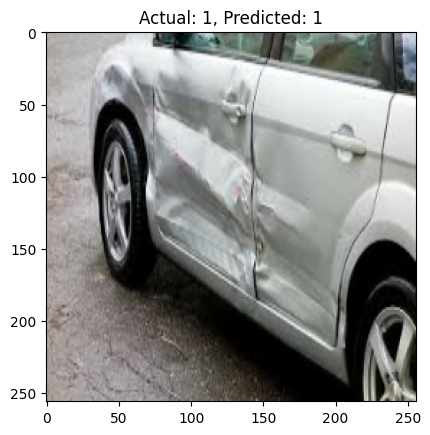

Actual: 2, Predicted: 2


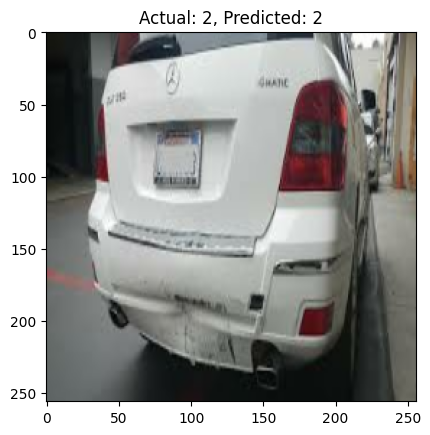

Actual: 1, Predicted: 1


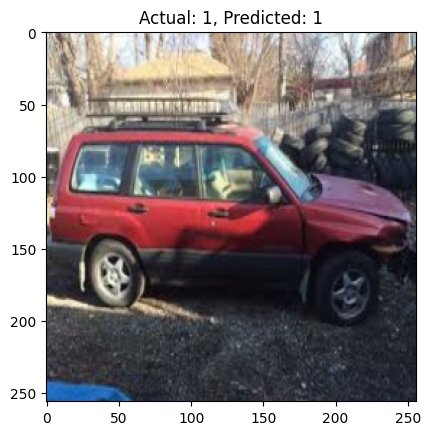

Actual: 0, Predicted: 0


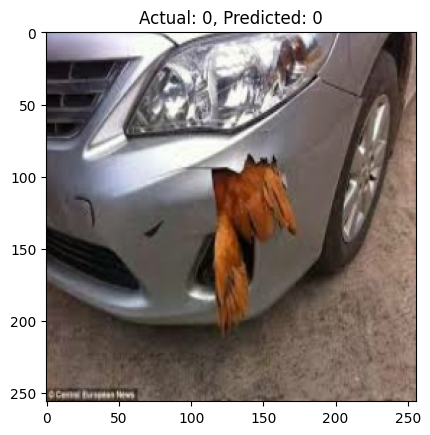

Actual: 2, Predicted: 2


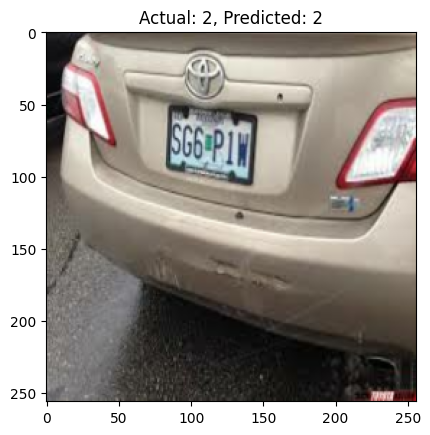

Actual: 2, Predicted: 1


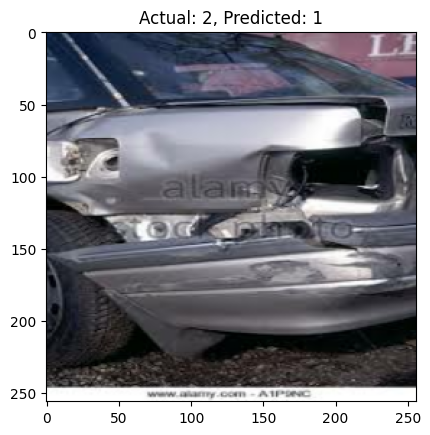

Actual: 1, Predicted: 1


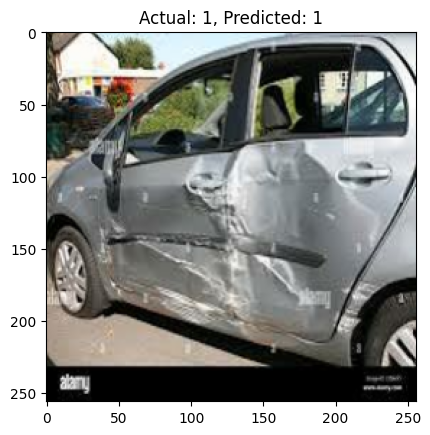

Actual: 1, Predicted: 1


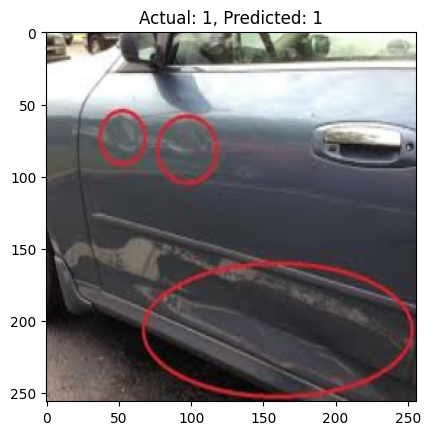

Actual: 3, Predicted: 3


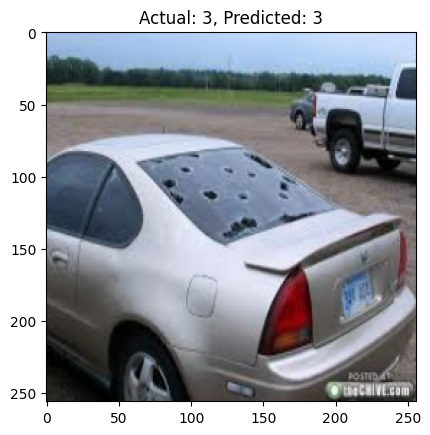

Actual: 1, Predicted: 1


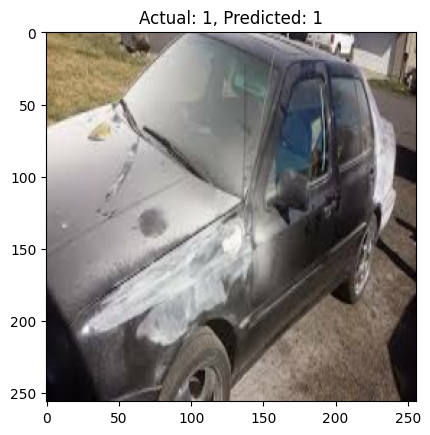

Actual: 2, Predicted: 2


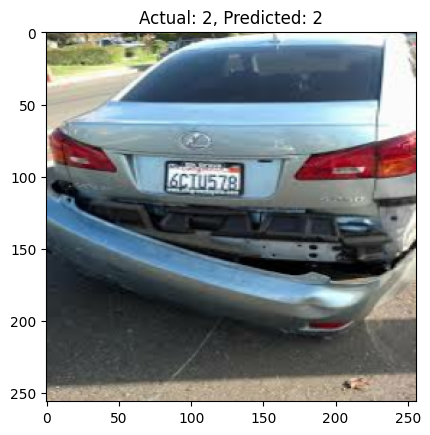

Actual: 2, Predicted: 2


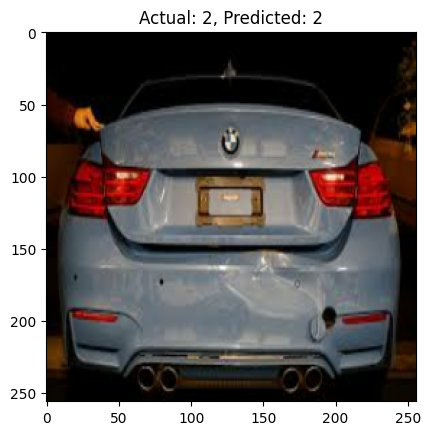

Actual: 0, Predicted: 0


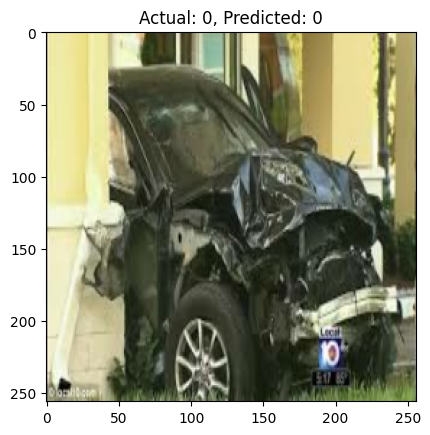

Actual: 1, Predicted: 1


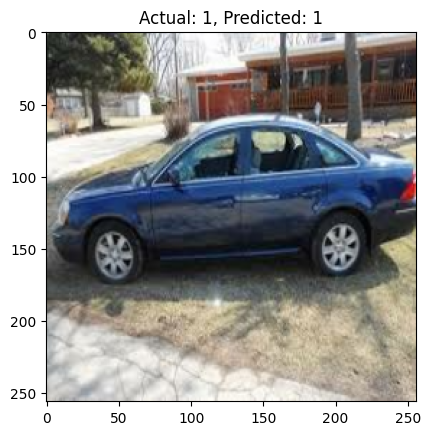

Actual: 2, Predicted: 2


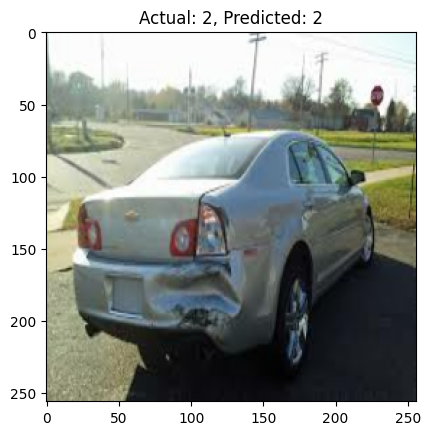

Actual: 0, Predicted: 1


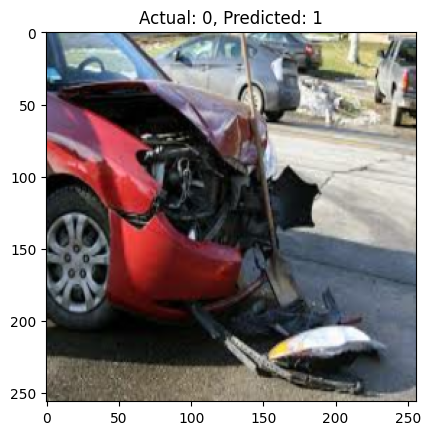

Actual: 3, Predicted: 3


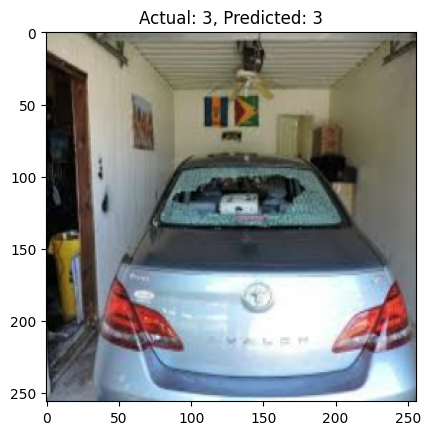

Actual: 1, Predicted: 1


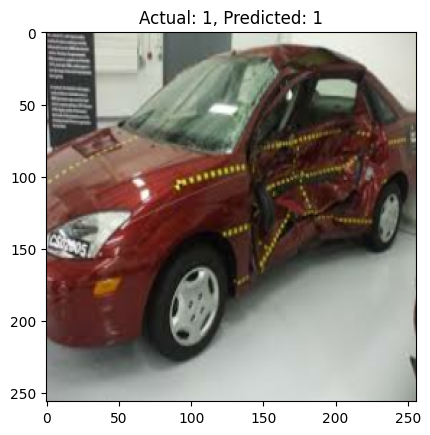

Actual: 0, Predicted: 0


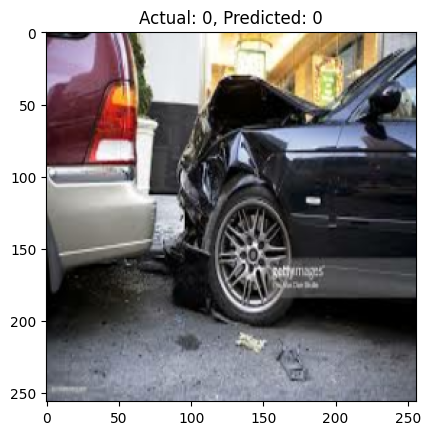

Actual: 1, Predicted: 1


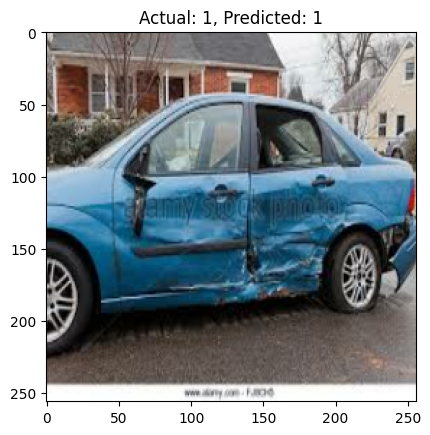

Actual: 0, Predicted: 0


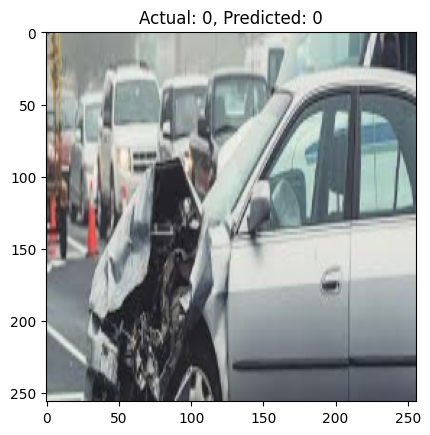

Actual: 0, Predicted: 0


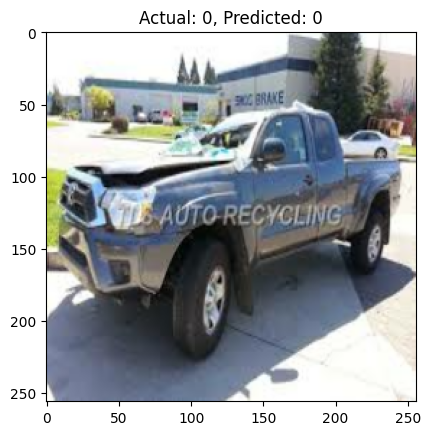

Actual: 1, Predicted: 1


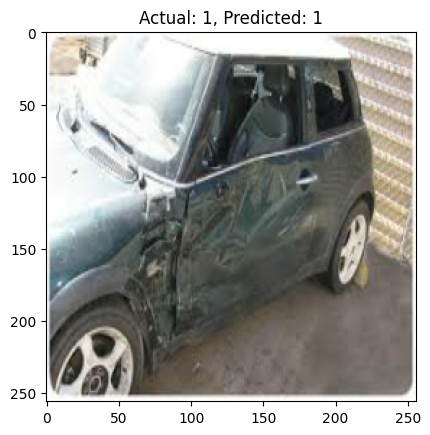

Actual: 0, Predicted: 0


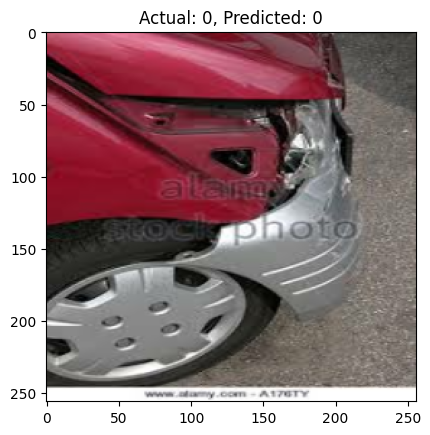

Actual: 2, Predicted: 2


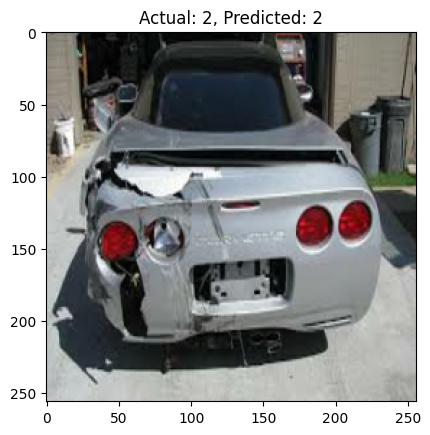

Actual: 1, Predicted: 1


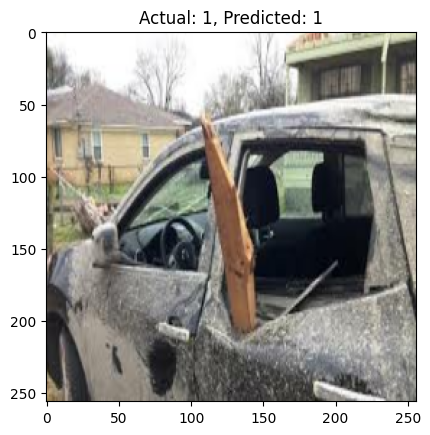

Actual: 0, Predicted: 0


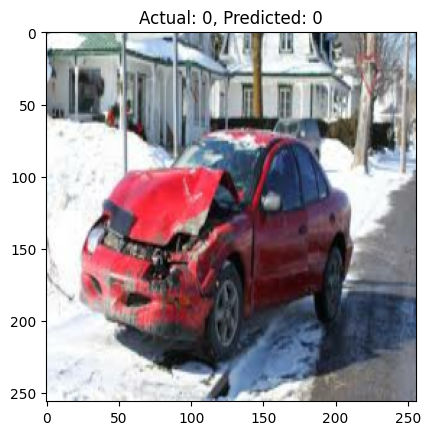

Actual: 1, Predicted: 1


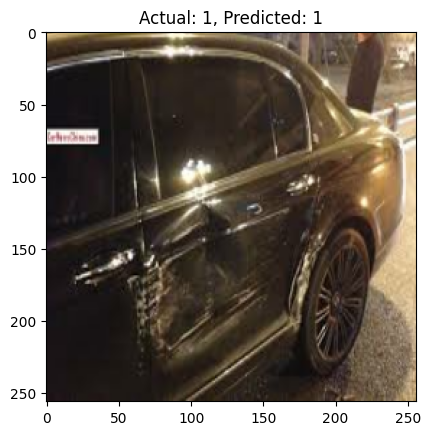

Actual: 0, Predicted: 0


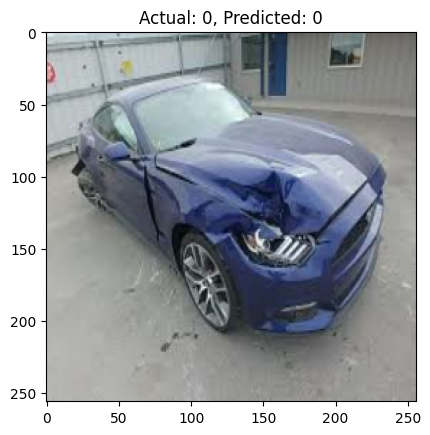

Actual: 1, Predicted: 1


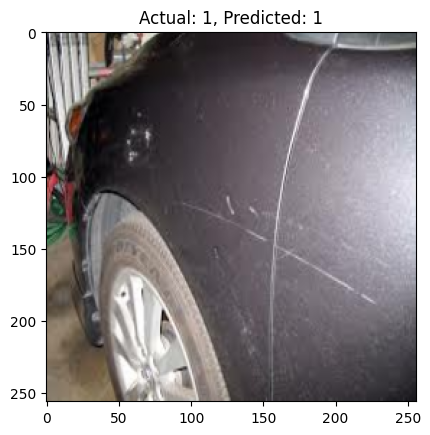

Actual: 0, Predicted: 0


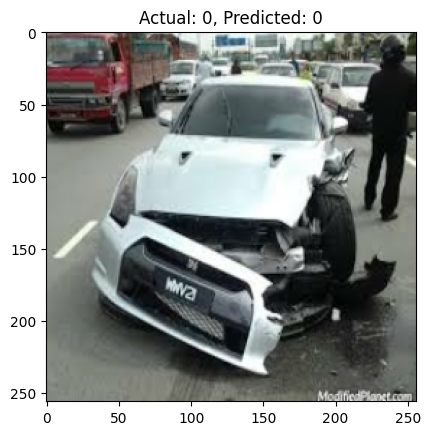

(32,) (32,)


In [33]:


pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)

    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    for i in range(len(y)):
        actual = y[i]
        predicted = yhat_classes[i]

        # Print actual and predicted labels
        print(f"Actual: {actual}, Predicted: {predicted}")

        # Display the image
        plt.imshow(X[i])
        plt.title(f"Actual: {actual}, Predicted: {predicted}")
        plt.show()
    print(y.shape,yhat_classes.shape)
    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y, yhat_classes)
    re.update_state(y, yhat_classes)
    acc.update_state(y, yhat_classes)




In [35]:
pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)

    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    # One-hot encode the labels
    y_one_hot = tf.keras.utils.to_categorical(y, num_classes=num_classes)


    for i in range(len(y)):
        actual = y_one_hot[i]
        predicted = tf.one_hot(yhat_classes[i], depth=num_classes)

        # Print actual and predicted labels
        print(f"Actual: {actual}, Predicted: {predicted}")

        # Display the image
        # plt.imshow(X[i])
        # plt.title(f"Actual: {actual}, Predicted: {predicted}")
        # plt.show()

    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y_one_hot, yhat)
    re.update_state(y_one_hot, yhat)
    acc.update_state(y_one_hot, yhat)

pre_result = pre.result().numpy()
re_result = re.result().numpy()
acc_result = acc.result().numpy()

print(f'Precision: {pre_result}, Recall: {re_result}, Accuracy: {acc_result}')


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
Actual: [0. 0. 1. 0.], Predicted: [0. 0. 1. 0.]
Actual: [0. 1. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [0. 0. 0. 1.], Predicted: [0. 0. 0. 1.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [0. 1. 0. 0.], Predicted: [0. 1. 0. 0.]
Actual: [0. 0. 0. 1.], Predicted: [0. 0. 0. 1.]
Actual: [0. 1. 0. 0.], Predicted: [0. 1. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [0. 0. 1. 0.], Predicted: [0. 0. 1. 0.]
Actual: [0. 0. 0. 1.], Predicted: [1. 0. 0. 0.]
Actual: [0. 0. 1. 0.], Predicted: [0. 0. 1. 0.]
Actual: [0. 1. 0. 0.], Predicted: [0. 1. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
A

In [36]:
print(f"Precision:{pre.result().numpy()}, Recall:{re.result().numpy()}, Accuracy:{acc.result().numpy()}")

Precision:0.8474576473236084, Recall:0.78125, Accuracy:0.828125


Test

In [42]:
import cv2

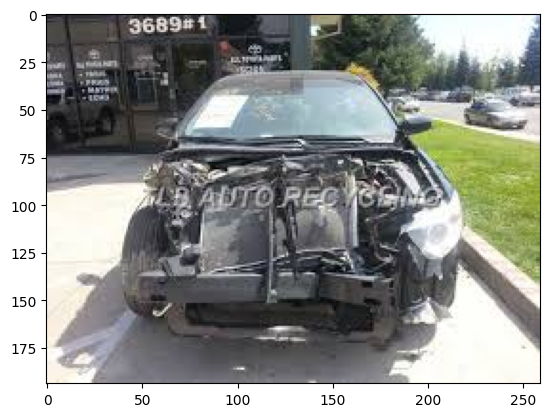

In [43]:
img=cv2.imread('test_image_1.jpeg')
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.show()

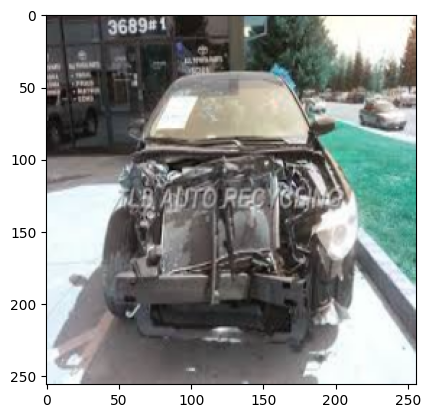

In [44]:
resize=tf.image.resize(img,(256,256))
plt.imshow(resize.numpy().astype(int))
plt.show()

In [45]:
yhat=model.predict(np.expand_dims(resize/255,0))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


In [46]:
predicted_class = np.argmax(yhat)
print(f'Predicted Class: {predicted_class}')

Predicted Class: 0


In [47]:
# Define the path where you want to save the model
model_path = "../DEPLOY_MODEL1/model2.h5"

# Save the model to the specified path
model.save(model_path)
